In [4]:
from GG_mthesis import *
%matplotlib inline

sns.set_style('whitegrid')
sns.set_palette('colorblind')
sns.set(font_scale=1.2)

In [5]:
os.getcwd()

'C:\\Users\\gian_\\repos\\mthesis_gianlucca'

In [7]:
base_sla_path = 'data/01_raw/geo_fronts/'
base_output_path = base_sla_path

adt_file_stem = 'adt_SO_'

base_mdt_path = 'data/AVISO/'
mdt_file_name      = 'mdt-cnes-cls18-global'

dataset_mdt = xr.open_dataset(base_mdt_path+mdt_file_name + '.nc')
dataset_adt = xr.open_dataset(base_sla_path+adt_file_stem + str(2017) + '.nc')

dataset_mdt = dataset_mdt.assign_coords(longitude=(((dataset_mdt.longitude + 180) % 360) - 180)).sortby('longitude')

dataset_mdt = dataset_mdt.interp(latitude=dataset_adt.latitude, longitude=dataset_adt.longitude)

#dataset_mdt.to_netcdf(path = base_mdt_path + mdt_file_name + '-grid.nc')

In [8]:
dataset_adt

<xarray.Dataset>
Dimensions:    (latitude: 141, longitude: 1438, time: 3)
Coordinates:
  * time       (time) datetime64[ns] 2017-11-09 2017-11-10 2017-11-11
  * longitude  (longitude) float64 -179.6 -179.4 -179.1 ... 179.1 179.4 179.6
  * latitude   (latitude) float64 -74.88 -74.62 -74.38 ... -40.38 -40.12 -39.88
Data variables:
    adt        (time, latitude, longitude) float64 ...
    err        (time, latitude, longitude) float64 ...
    sla        (time, latitude, longitude) float64 ...
Attributes: (12/47)
    CDI:                             Climate Data Interface version 1.9.5 (ht...
    Conventions:                     CF-1.6
    history:                         2020-12-07 20:44:10Z: Creation
    source:                          Altimetry measurements
    institution:                     CLS, CNES
    Metadata_Conventions:            Unidata Dataset Discovery v1.0
    ...                              ...
    time_coverage_end:               2020-06-03T00:00:00Z
    time_coverage_resolution:        P1D
    time_coverage_start:             2020-06-03T00:00:00Z
    title:                           DT merged all satellites Global Ocean Gr...
    History:                         Translated to CF-1.0 Conventions by Netc...
    CDO:                             Climate Data Operators version 1.9.5 (ht...

C:\Users\gian_\AppData\Local\Temp/ipykernel_5304/2369277026.py:7: MatplotlibDeprecationWarning: The 'extend' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  adt_colorbar = fig.colorbar(colour_ax, label='Sea Level Anomaly ($m$)', extend='max')


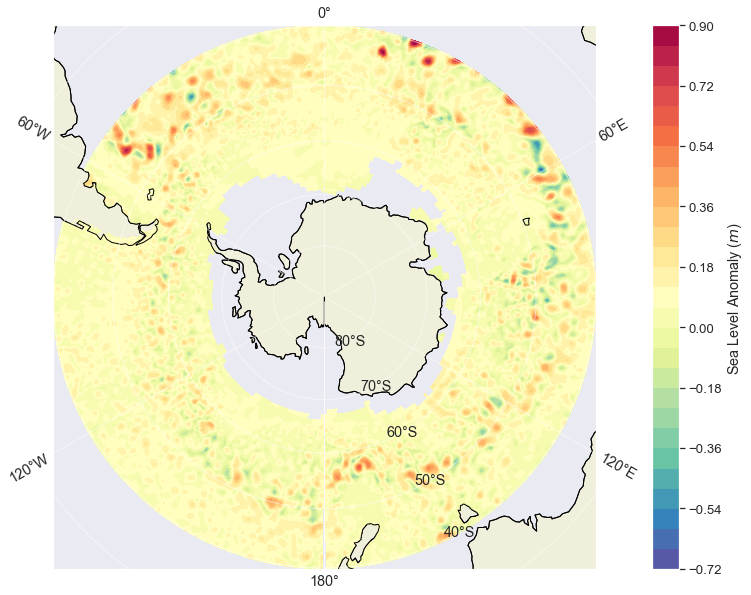

In [9]:
fig, ax = plt.subplots(1, figsize=(20,10),
                    subplot_kw={'projection': ccrs.SouthPolarStereo()})
#plot_circle_boundary()

colour_ax = ax.contourf(dataset_adt.longitude, dataset_adt.latitude, dataset_adt.sla[0], transform=ccrs.PlateCarree(), cmap='Spectral_r', levels=25)

adt_colorbar = fig.colorbar(colour_ax, label='Sea Level Anomaly ($m$)', extend='max')

ax.gridlines(draw_labels=True, alpha=0.5, dms=True)
#geo_axes.stock_img()
ax.coastlines()
ax.add_feature(cartopy.feature.LAND, edgecolor='black')

plt.savefig('C:\\Users\\gian_\\repos\\mthesis_gianlucca\\results\\analysis\\sla_AVISO.png', bbox_inches='tight', format='png')
plt.show()

C:\Users\gian_\AppData\Local\Temp/ipykernel_5304/1105314086.py:7: MatplotlibDeprecationWarning: The 'extend' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  mdt_colorbar = fig.colorbar(colour_ax, label='Mean dynamic topography ($m$)', extend='max')


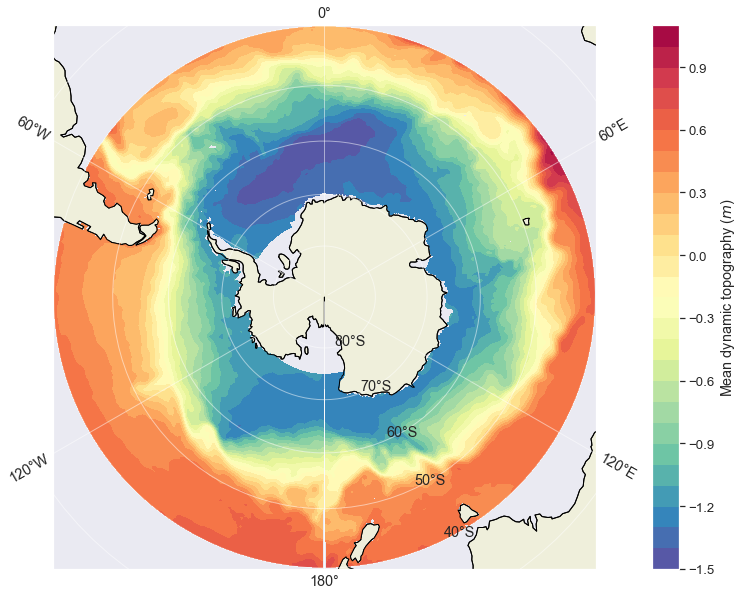

In [10]:
fig, ax = plt.subplots(figsize=(20,10),
                    subplot_kw={'projection': ccrs.SouthPolarStereo()})
#plot_circle_boundary()

colour_ax = ax.contourf(dataset_mdt.longitude, dataset_mdt.latitude, dataset_mdt.mdt[0], transform=ccrs.PlateCarree(), cmap='Spectral_r', levels=25)

mdt_colorbar = fig.colorbar(colour_ax, label='Mean dynamic topography ($m$)', extend='max')

ax.gridlines(draw_labels=True, alpha=0.5, dms=True)
#geo_axes.stock_img()
ax.coastlines()
ax.add_feature(cartopy.feature.LAND, edgecolor='black')

plt.savefig('C:\\Users\\gian_\\repos\\mthesis_gianlucca\\results\\analysis\\mdt_AVISO.png', bbox_inches='tight', format='png')
plt.show()

writing file to:  data/01_raw/geo_fronts/jet_detection_Southern_Ocean_2_2017.nc
time step:  0  of  3
c:\users\gian_\repos\mthesis_gianlucca\src\GG_mthesis\Wavelet_Jet_Detection.py:434: RuntimeWarning: invalid value encountered in double_scalars
  slope = (end_value-start_value)/(end_y-start_y)
time step:  1  of  3
time step:  2  of  3


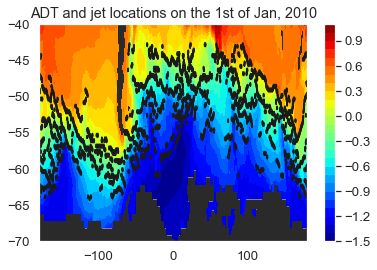

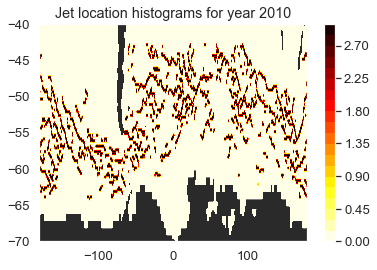

In [11]:
import numpy as np
from matplotlib import pyplot as plt
from netCDF4 import Dataset
from GG_mthesis import Wavelet_Jet_Detection

#This is an example script showing how to use, and save, the WHOSE jet detection
#alogorithm. The example uses AVISO gridded altimetry (ADT) in the north Pacific region
#with a focus on the Kuroshio current. The example ADT file can be downloaded 
#from 



#=========================#
# WAVELET PARAMETERS
#=========================#
N_DECOMP_LEVELS = 4
confidence_param = 0.9

#============================#
#Set the gradient threshold
grad_thres = 0.001 #(units: m/km - reported in text as m/100km)
#============================#

#Start year and end year 
START_YEAR = 2017
END_YEAR   = 2018

#==================================================#
#Input and output paths of the files
base_sla_path = 'data/01_raw/geo_fronts/'
base_output_path = base_sla_path

adt_file_stem = 'adt_SO_'
output_file_stem = 'jet_detection_Southern_Ocean_2_'

base_mdt_path = 'data/AVISO/'
mdt_file_name      = 'mdt-cnes-cls18-global-grid.nc'


#==================================================#


#==========================#
#Here we instantiate the
#wavelet jet detection class
#==========================#
wavelet_jet_detector = Wavelet_Jet_Detection.Jet_Detector(N_DECOMP_LEVELS,confidence_param,wavelet_basis='haar',
                       grad_thresh=grad_thres)
#==========================#                    
#some counters
time_counter = 0
start_lon = 0

#==========================#
#Get the MDT
#==========================#
dataset_mdt = Dataset(base_mdt_path+mdt_file_name,'r')
lat_mdt         = dataset_mdt.variables['latitude'][:]
lon_mdt         = dataset_mdt.variables['longitude'][:]
mdt             = dataset_mdt.variables['mdt'][:,:,:]


for i_year in range(START_YEAR,END_YEAR):
    
    #Load input data
    dataset_adt = Dataset(base_sla_path+adt_file_stem + str(i_year) + '.nc','r')
    sla         = dataset_adt.variables['sla'][:,:,:]
    time        = dataset_adt.variables['time'][:]    
    lat_adt     = dataset_adt.variables['latitude'][:]
    lon_adt     = dataset_adt.variables['longitude'][:]
    
    
    nT    = time.size   
    n_lon = lon_adt.size
    n_lat = lat_adt.size
    min_lat = lat_adt.min()
    max_lat = lat_adt.max()
    
    min_index = np.nonzero(lat_adt>=min_lat)[0][0]
    max_index = np.nonzero(lat_adt>=max_lat)[0][0]+1
        
    lat_mdt = lat_mdt[min_index:max_index]
    mdt     = mdt[:,min_index:max_index,:]
    adt = mdt + 1.0e-4*sla
    
    
    jet_histogram = np.zeros([n_lat,n_lon],dtype='u4')
    jet_locations = np.zeros([nT,n_lat,n_lon],dtype='u4')

    #============================#
    #Set up the output file
    #============================#
    print('writing file to: ', base_output_path+output_file_stem + str(i_year)+'.nc')
    dataset_out        = Dataset(base_output_path+output_file_stem + str(i_year)+'.nc',
                                'w',clobber=True, format='NETCDF4')
                                                           
    dataset_out.createDimension('time', None)
    var_time = dataset_out.createVariable('time', 'f8', ['time'])

    dataset_out.createDimension('lat', n_lat)
    dataset_out.createDimension('lon', n_lon)
    var_lat = dataset_out.createVariable('lat', 'f8', ['lat'])
    var_lon = dataset_out.createVariable('lon', 'f8', ['lon'])
    var_time[:] = time

    var_lat[:] = lat_adt
    var_lon[:] = lon_adt
    var_hist      = dataset_out.createVariable('jet_loc_hist', 'f8', ['lat','lon'])
    var_locations = dataset_out.createVariable('jet_locations', 'f8', ['time','lat','lon'])
    #============================#
    
    for iT in range(0,nT): # nT):
        print("time step: ", iT, " of ", nT)
        for i_lon in range(start_lon,n_lon):
            adt_slice = adt[iT,:,i_lon]
            adt_slice[adt_slice.mask] = np.nan
            
            #================================================================#
            #Here's where the magic happens
            #For each meridional transect, and at each time step, we apply the 
            #methodology.
            #================================================================#
            lon_positions, lat_positions = wavelet_jet_detector.detect_jets(lon_adt[i_lon]*np.ones(n_lat), lat_adt,adt_slice,only_eastward=True)
            
            
            for i_jet in range(0,len(lat_positions)):
                index_y = np.nonzero(lat_adt>=lat_positions[i_jet])[0][0]     
                jet_histogram[index_y,i_lon] = jet_histogram[index_y,i_lon]+1
                jet_locations[iT,index_y,i_lon] = 1
    var_locations[0:nT,:,:] =  jet_locations 
    time_counter = time_counter+nT    
    
        
    dataset_adt.close()
    var_hist[:,:] = jet_histogram/float(time_counter)
    dataset_out.close()  

topo_mask = np.isnan(adt[0,:,:])
jet_histogram_masked = np.ma.masked_where(topo_mask, jet_histogram)


#Let's make some plots
fig  = plt.figure(1)
ax   = fig.add_subplot(1,1,1)
ax.contourf(lon_adt,lat_adt,jet_histogram_masked.mask,2,cmap=plt.cm.gray_r)

cs = ax.contourf(lon_adt,lat_adt,adt[0,:,:],25,cmap=plt.cm.jet)
fig.colorbar(cs)
ax.contour(lon_adt,lat_adt,jet_locations[0,:,:],2,colors='k')
ax.set_title('ADT and jet locations on the 1st of Jan, 2010')
ax.set_ylim([-70,-40])
plt.show()



fig  = plt.figure(2)
ax   = fig.add_subplot(1,1,1)
ax.contourf(lon_adt,lat_adt,jet_histogram_masked.mask,2,cmap=plt.cm.gray_r)

cs = ax.contourf(lon_adt,lat_adt,jet_histogram_masked,25,cmap=plt.cm.hot_r)
fig.colorbar(cs)
ax.set_title('Jet location histograms for year 2010')
ax.set_ylim([-70,-40])

plt.show()


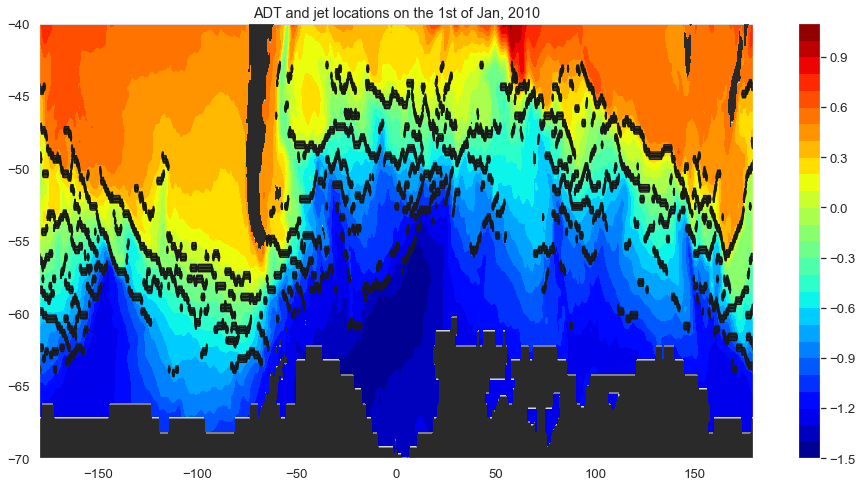

In [12]:
#Let's make some plots
fig  = plt.figure(figsize=(16,8))
ax   = fig.add_subplot(1,1,1)
ax.contourf(lon_adt,lat_adt,jet_histogram_masked.mask,2,cmap=plt.cm.gray_r)

cs = ax.contourf(lon_adt,lat_adt,adt[0,:,:],25,cmap=plt.cm.jet)
fig.colorbar(cs)
ax.contour(lon_adt,lat_adt,jet_locations[0,:,:],2,colors='k')
ax.set_title('ADT and jet locations on the 1st of Jan, 2010')
ax.set_ylim([-70,-40])

plt.savefig('C:\\Users\\gian_\\repos\\mthesis_gianlucca\\results\\analysis\\WHOSE_fronts.png', bbox_inches='tight', format='png')
plt.show()

C:\Users\gian_\AppData\Local\Temp/ipykernel_5304/3223965795.py:7: MatplotlibDeprecationWarning: The 'extend' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  adt_colorbar = fig.colorbar(colour_ax, label='Absolute Dynamic Topographgy ($m$)', extend='max')


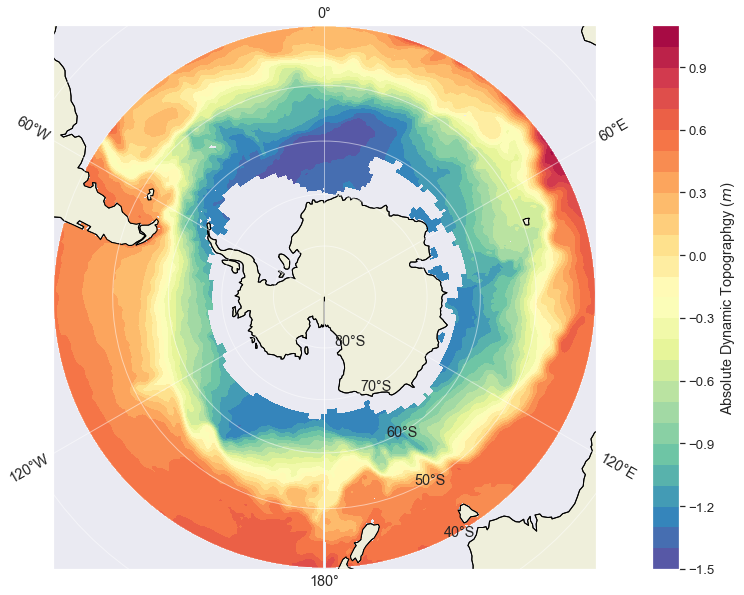

In [13]:
fig, ax = plt.subplots(1, figsize=(20,10),
                    subplot_kw={'projection': ccrs.SouthPolarStereo()})
#plot_circle_boundary()

colour_ax = ax.contourf(lon_adt, lat_adt, adt[0], transform=ccrs.PlateCarree(), cmap='Spectral_r', levels=25)

adt_colorbar = fig.colorbar(colour_ax, label='Absolute Dynamic Topographgy ($m$)', extend='max')

ax.gridlines(draw_labels=True, alpha=0.5, dms=True)
#geo_axes.stock_img()
ax.coastlines()
ax.add_feature(cartopy.feature.LAND, edgecolor='black')

plt.savefig('C:\\Users\\gian_\\repos\\mthesis_gianlucca\\results\\analysis\\adt_calculated.png', bbox_inches='tight', format='png')
plt.show()

C:\Users\gian_\AppData\Local\Temp/ipykernel_5304/3622895735.py:8: MatplotlibDeprecationWarning: The 'extend' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  adt_colorbar = fig.colorbar(colour_ax, label='Absolute dynamic topography ($m$)', extend='max')


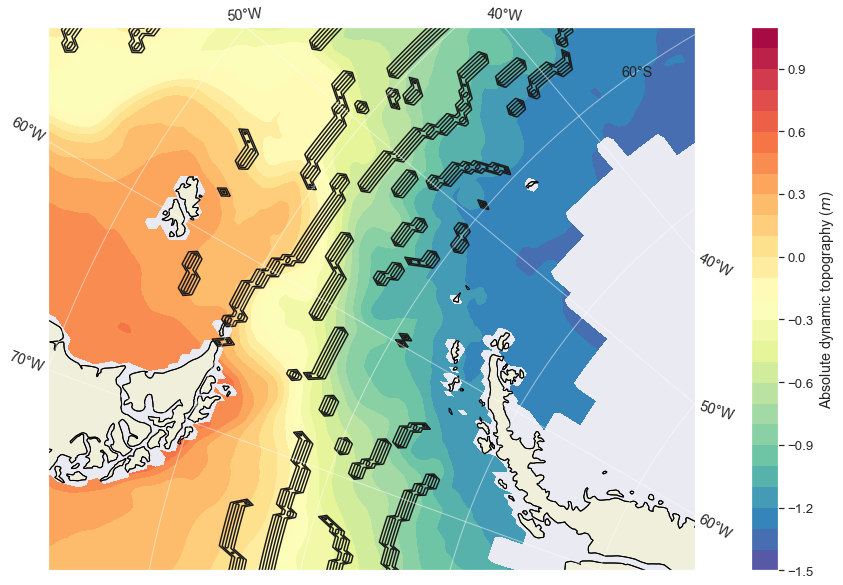

In [14]:
fig, ax = plt.subplots(figsize=(20,10),
                    subplot_kw={'projection': ccrs.SouthPolarStereo()})
#plot_circle_boundary()

colour_ax = ax.contourf(lon_adt, lat_adt, adt[1], transform=ccrs.PlateCarree(), cmap='Spectral_r', levels=25)
ax.contour(lon_adt, lat_adt, jet_locations[1,:,:], levels=2, transform=ccrs.PlateCarree(), colors='k')

adt_colorbar = fig.colorbar(colour_ax, label='Absolute dynamic topography ($m$)', extend='max')

ax.gridlines(draw_labels=True, alpha=0.5, dms=True)
#geo_axes.stock_img()
ax.coastlines()
ax.add_feature(cartopy.feature.LAND, edgecolor='black')
ax.set_extent([-70, -50, -70, -50])

plt.savefig('C:\\Users\\gian_\\repos\\mthesis_gianlucca\\results\\analysis\\geo_fronts_region.png', bbox_inches='tight', format='png')

In [15]:
120%360

120